___
## Diagnóstico dos dados

- Com base nas análises anteriores (gráficos de dispersão, pair plots e distribuição de variáveis categóricas, valores únicos), podemos avaliar a qualidade dos dados considerando os seguintes aspectos:
- Colunas que possuem valores nulos como “?” que serão consideradas como nulo. `[‘weight’, ‘medical_specialty’,  'diag_1', 'diag_2', 'diag_3']`
- Colunas de Id serão excluídas na etapa de Pré-Processamento devido a falta de correlação e causalidade na variável alvo. `['encounter_id', 'patient_nbr, 'diag_1', 'diag_2', 'diag_3']`
- Valores Ausentes: Algumas colunas apresentam dados faltantes, nas variáveis. `[‘max_glu_serum’, ‘A1Cresult’, ‘weight’, ‘medical_specialty’,  'diag_1', 'diag_2', 'diag_3']`
- Outliers: Foram identificados valores extremos em variáveis como Número de procedimentos laboratoriais, Tempo de internação, Número de procedimentos médicos e Número de diagnósticos;
- Padronização das variáveis: padronização de escalas para garantir melhor desempenho dos algoritmos de aprendizado de máquina;
- Algumas colunas de medicamentos se comportam erroneamente como categorias binárias, mas ao checar o comportamento de outras colunas de medicamentos vemos que o padrão de resposta se consiste em 4 opções:

    1. up” if the dosage was increased during the encounter

    2. “down” if the dosage was decreased
    
    3. “steady” if the dosage did not change
    
    4. “no” if the drug was not prescribed

- Desbalanceamento em algumas variáveis categóricas, que precisarão da utilização de técnicas de balanceamento de dados como SMOTE, por exemplo.
Algumas classes apresentam baixa representatividade, como diagnósticos raros, faixas etárias específicas, procedimentos médicos pouco frequentes e categorias de alta complexidade hospitalar

- Variável Alvo possui 3 categorias ['NO' '>30' '<30'] indicando que não houve readmissao e se houve readmissão com menos de 30 dias ou mais de 30 dias.

___

In [2]:
# importando as bibliotecas
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [3]:
# carregar o dataset
df = pd.read_csv('data/diabetes.csv')
df.info()
df.shape

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 75832 entries, 0 to 75831
Data columns (total 50 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   encounter_id              75832 non-null  float64
 1   patient_nbr               75832 non-null  float64
 2   race                      75832 non-null  object 
 3   gender                    75832 non-null  object 
 4   age                       75832 non-null  object 
 5   weight                    75832 non-null  object 
 6   admission_type_id         75832 non-null  float64
 7   discharge_disposition_id  75832 non-null  float64
 8   admission_source_id       75832 non-null  float64
 9   time_in_hospital          75832 non-null  float64
 10  payer_code                75832 non-null  object 
 11  medical_specialty         75832 non-null  object 
 12  num_lab_procedures        75832 non-null  float64
 13  num_procedures            75832 non-null  float64
 14  num_me

(75832, 50)

Ler os dados

In [5]:
df.head()

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide.metformin,glipizide.metformin,glimepiride.pioglitazone,metformin.rosiglitazone,metformin.pioglitazone,change,diabetesMed,readmitted
0,2278392.0,8222157.0,Caucasian,Female,[0-10),?,6.0,25.0,1.0,1.0,...,No,No,No,No,No,No,No,No,No,NO
1,149190.0,55629189.0,Caucasian,Female,[10-20),?,1.0,1.0,7.0,3.0,...,No,Up,No,No,No,No,No,Ch,Yes,>30
2,64410.0,86047875.0,AfricanAmerican,Female,[20-30),?,1.0,1.0,7.0,2.0,...,No,No,No,No,No,No,No,No,Yes,NO
3,500364.0,82442376.0,Caucasian,Male,[30-40),?,1.0,1.0,7.0,2.0,...,No,Up,No,No,No,No,No,Ch,Yes,NO
4,16680.0,42519267.0,Caucasian,Male,[40-50),?,1.0,1.0,7.0,1.0,...,No,Steady,No,No,No,No,No,Ch,Yes,NO


In [6]:
df.describe()

,encounter_id,patient_nbr,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
count,7.583200e+04,7.583200e+04,75832.000000,75832.000000,75832.000000,75832.000000,75832.000000,75832.000000,75832.000000,75832.000000,75832.000000,75832.000000,75832.000000
mean,1.162530e+08,4.659672e+07,2.125831,3.949876,5.866798,4.477015,43.141207,1.339369,15.743130,0.320261,0.166711,0.623985,7.196566
std,5.813977e+07,3.571536e+07,1.527104,5.610895,4.348319,3.031160,19.123581,1.681773,8.151756,1.160432,0.729874,1.239269,1.980746
min,1.252200e+04,1.350000e+02,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
25%,6.807618e+07,1.780539e+07,1.000000,1.000000,1.000000,2.000000,32.000000,0.000000,10.000000,0.000000,0.000000,0.000000,6.000000
50%,1.176942e+08,4.075393e+07,1.000000,1.000000,7.000000,4.000000,44.000000,1.000000,14.000000,0.000000,0.000000,0.000000,8.000000
75%,1.629026e+08,8.354232e+07,3.000000,5.000000,7.000000,6.000000,56.000000,2.000000,20.000000,0.000000,0.000000,1.000000,9.000000
max,2.281685e+08,1.152185e+08,8.000000,28.000000,22.000000,14.000000,129.000000,6.000000,81.000000,42.000000,42.000000,21.000000,9.000000


In [7]:
# Identificar variáveis categóricas e contínuas
categorical_vars = df.select_dtypes(include=['object', 'category']).columns
continuous_vars = df.select_dtypes(include=['int64', 'float64']).columns

# Exibir a quantidade de cada tipo
print(f"Quantidade de variáveis categóricas: {len(categorical_vars)}")
print(f"Quantidade de variáveis contínuas: {len(continuous_vars)}")

# Exibir os nomes das variáveis
print("\nVariáveis categóricas:", len(categorical_vars))
print("\nVariáveis contínuas:", len(continuous_vars))

Quantidade de variáveis categóricas: 37
Quantidade de variáveis contínuas: 13

Variáveis categóricas: 37

Variáveis contínuas: 13


In [8]:
# unique values in each column format
for col in df.columns:
    print(f'{col}: {df[col].unique()}\n')

encounter_id: [2.27839200e+06 1.49190000e+05 6.44100000e+04 ... 2.28159504e+08
 2.28163032e+08 2.28168510e+08]

patient_nbr: [ 8222157. 55629189. 86047875. ... 75948840. 42999489. 84850344.]

race: ['Caucasian' 'AfricanAmerican' '?' 'Other' 'Asian' 'Hispanic']

gender: ['Female' 'Male' 'Unknown/Invalid']

age: ['[0-10)' '[10-20)' '[20-30)' '[30-40)' '[40-50)' '[50-60)' '[60-70)'
 '[70-80)' '[80-90)' '[90-100)']

weight: ['?' '[75-100)' '[50-75)' '[0-25)' '[100-125)' '[25-50)' '[125-150)'
 '[175-200)' '[150-175)' '>200']

admission_type_id: [6. 1. 2. 3. 4. 5. 8. 7.]

discharge_disposition_id: [25.  1.  3.  6.  2.  5. 11.  7. 10.  4. 14. 18.  8. 13. 12. 16. 17. 22.
 23.  9. 20. 15. 24. 28. 19. 27.]

admission_source_id: [ 1.  7.  2.  4.  5.  6. 20.  3. 17.  8.  9. 14. 10. 22.]

time_in_hospital: [ 1.  3.  2.  4.  5. 13. 12.  9.  7. 10.  6. 11.  8. 14.]

payer_code: ['?' 'MC' 'MD' 'HM' 'UN' 'BC' 'SP' 'CP' 'SI' 'DM' 'CM' 'CH' 'PO' 'WC' 'OT'
 'OG' 'MP']

medical_specialty: ['Pediatrics-Endo

In [9]:
# Printa valores iguais a ? nas colunas
for col in df.columns:
    # print se a contagem por > 0
    if df[col].apply(lambda x: x == '?').sum() > 0:
        print(f'{col}: {df[col].apply(lambda x: x == "?").sum()}')

race: 1511
weight: 73317
payer_code: 37437
medical_specialty: 32475
diag_1: 18
diag_2: 321
diag_3: 1284


In [ ]:
# substitua os valores ? por np.nan
df = df.replace('?', np.nan)

# Printa valores iguais a nulo nas colunas
for col in df.columns:
    # print se a contagem por > 0
    if df[col].isnull().sum() > 0:
        print(f'{col}: {df[col].isnull().sum()}')

race: 1511
weight: 73317
payer_code: 37437
medical_specialty: 32475
diag_1: 18
diag_2: 321
diag_3: 1284
max_glu_serum: 70842
A1Cresult: 63534


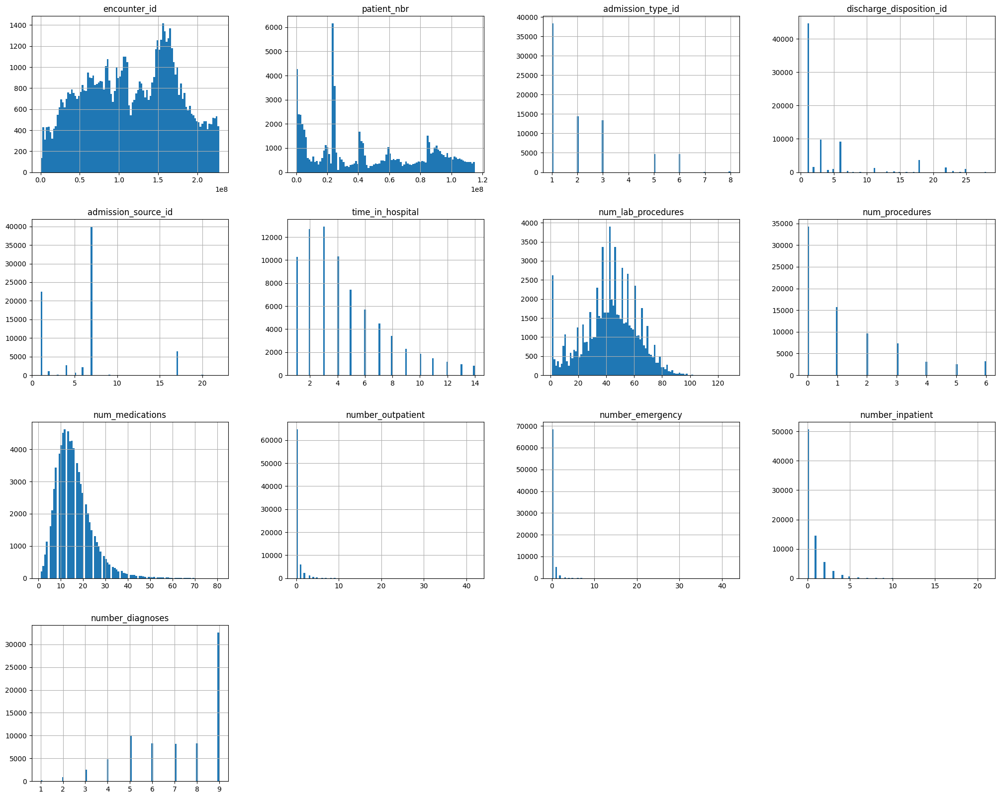

Histogramas e Gráficos de Distribuição: Mostram a distribuição de cada variável.


In [11]:
# 1. Histogramas e Gráficos de Distribuição
# Os histogramas mostram a distribuição de cada variável.
# Podemos observar a distribuição de valores e identificar possíveis outliers.
df.hist(bins=100, figsize=(25, 20))

plt.show()
print("Histogramas e Gráficos de Distribuição: Mostram a distribuição de cada variável.")

Gráficos de Dispersão (Scatter Plots): Mostram a relação entre pares de variáveis.


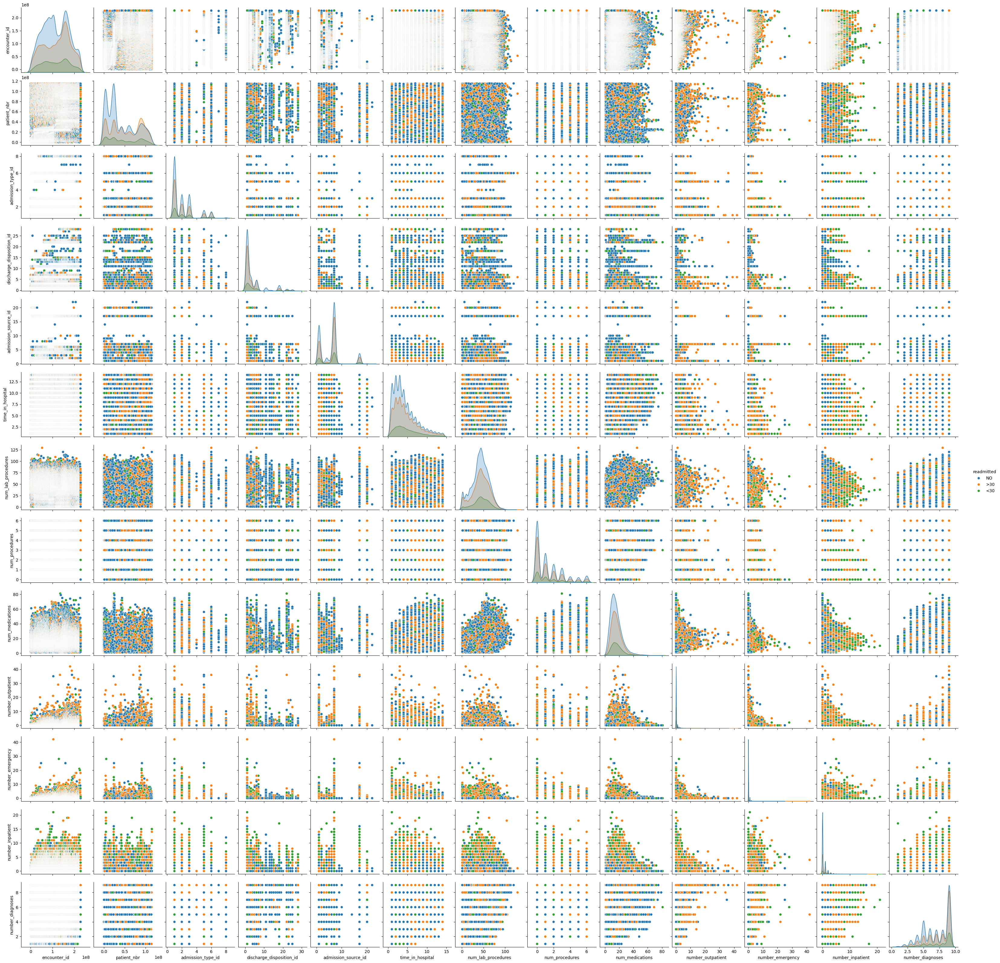

In [12]:
sns.pairplot(df, diag_kind='kde', hue='readmitted', height=2.5)
# plt.show()
print("Gráficos de Dispersão (Scatter Plots): Mostram a relação entre pares de variáveis.")

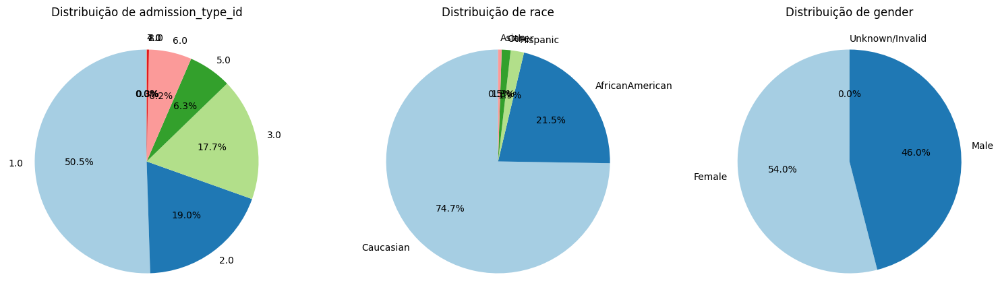

In [13]:

# Suponha que 'df' seja o DataFrame e queremos analisar a distribuição de uma variável categórica
categorical_columns = ["admission_type_id", "race", "gender"]  # Substitua pelos nomes das colunas categóricas no seu dataset

fig, axes = plt.subplots(1, len(categorical_columns), figsize=(5 * len(categorical_columns), 5))

# Se houver apenas uma variável categórica, garantir que 'axes' seja uma lista
if len(categorical_columns) == 1:
    axes = [axes]

for ax, col in zip(axes, categorical_columns):
    data = df[col].value_counts()  # Conta a frequência de cada categoria
    ax.pie(data, labels=data.index, autopct='%1.1f%%', startangle=90, colors=plt.cm.Paired.colors)
    ax.set_title(f"Distribuição de {col}")

plt.tight_layout()
plt.show()


Gráficos de Dispersão (Scatter Plots): Mostram a relação entre pares de variáveis.


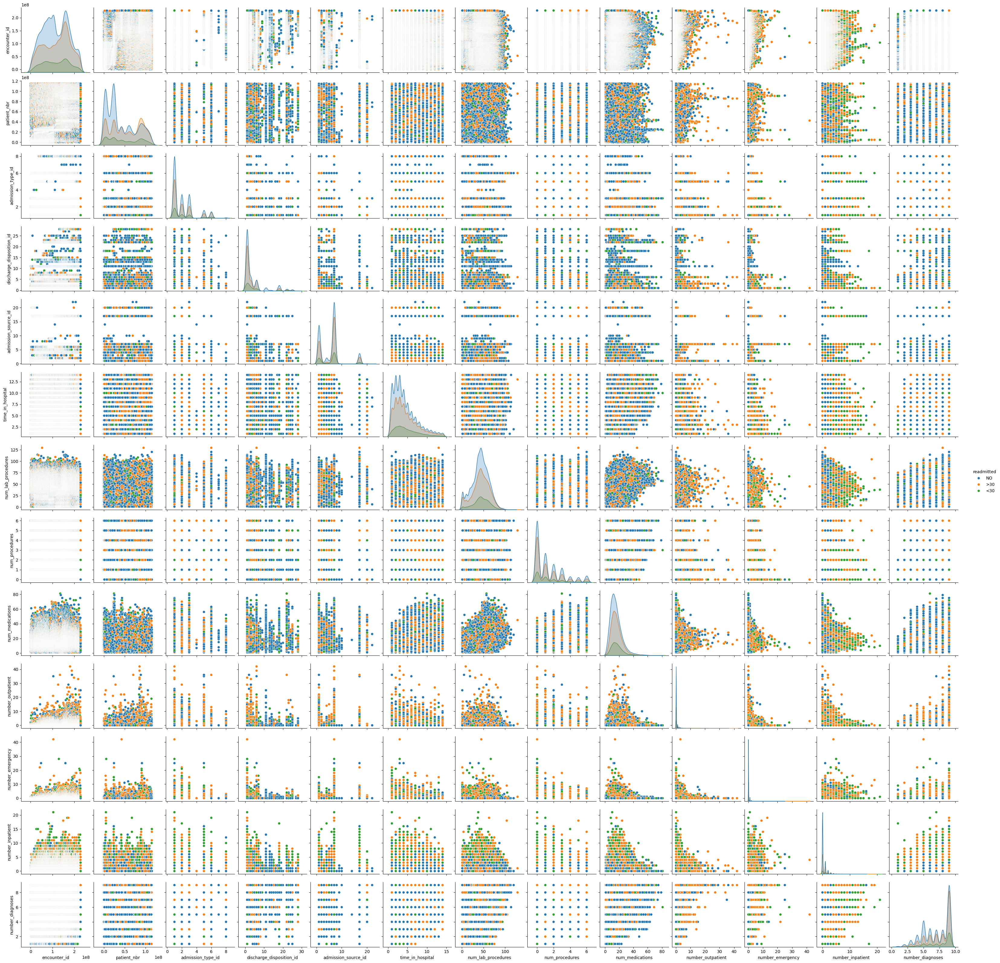

In [14]:
sns.pairplot(df, diag_kind='kde', hue='readmitted', height=2.5)
# plt.show()
print("Gráficos de Dispersão (Scatter Plots): Mostram a relação entre pares de variáveis.")

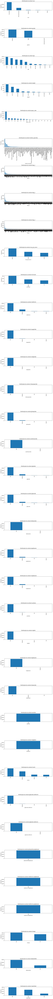

In [15]:
# Selecionar apenas colunas categóricas
categorical_columns = df.select_dtypes(include=['object']).columns

# Criar gráficos de barras para variáveis categóricas
fig, axes = plt.subplots(len(categorical_columns), 1, figsize=(10, len(categorical_columns) * 5))

for col, ax in zip(categorical_columns, axes):
    df[col].value_counts().plot(kind='bar', ax=ax)
    ax.set_title(f'Distribuição da variável {col}')
    ax.set_ylabel('Frequência')

plt.tight_layout()
plt.show()

In [16]:
# df sem a coluna de classe
df = df.drop(df.columns[-1], axis=1)

In [17]:
df.shape

(75832, 49)

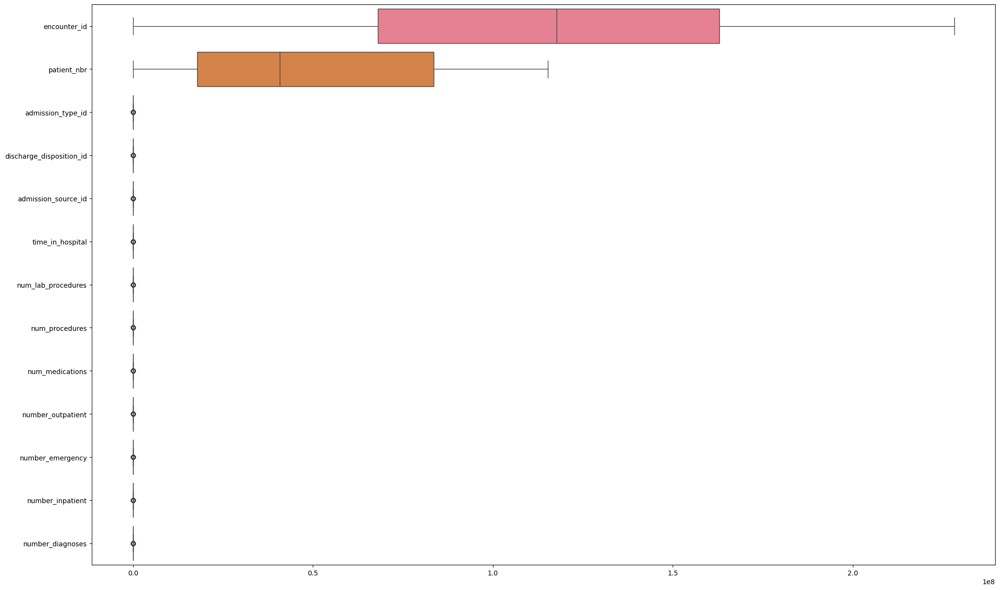

Box Plots: Mostram a distribuição de cada variável.


In [18]:
# 4. Box Plots
# Os box plots mostram a distribuição de cada variável, permitindo identificar outliers e entender a distribuição dos dados.
plt.figure(figsize=(24, 15))
sns.boxplot(data=df, orient="h")
plt.show()
print("Box Plots: Mostram a distribuição de cada variável.")


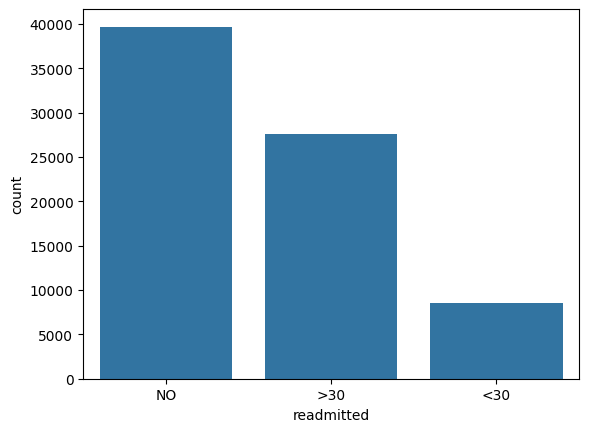

Gráficos de Barras e Gráficos de Pizza: Mostram a contagem de cada classe no dataset.


In [4]:
# 5. Gráficos de Barras e Gráficos de Pizza
# Os gráficos de barras mostram a contagem de cada classe no dataset.
# Eles nos ajudam a entender a distribuição das classes e se o dataset está balanceado.
sns.countplot(data=df, x='readmitted')
plt.show()
print("Gráficos de Barras e Gráficos de Pizza: Mostram a contagem de cada classe no dataset.")

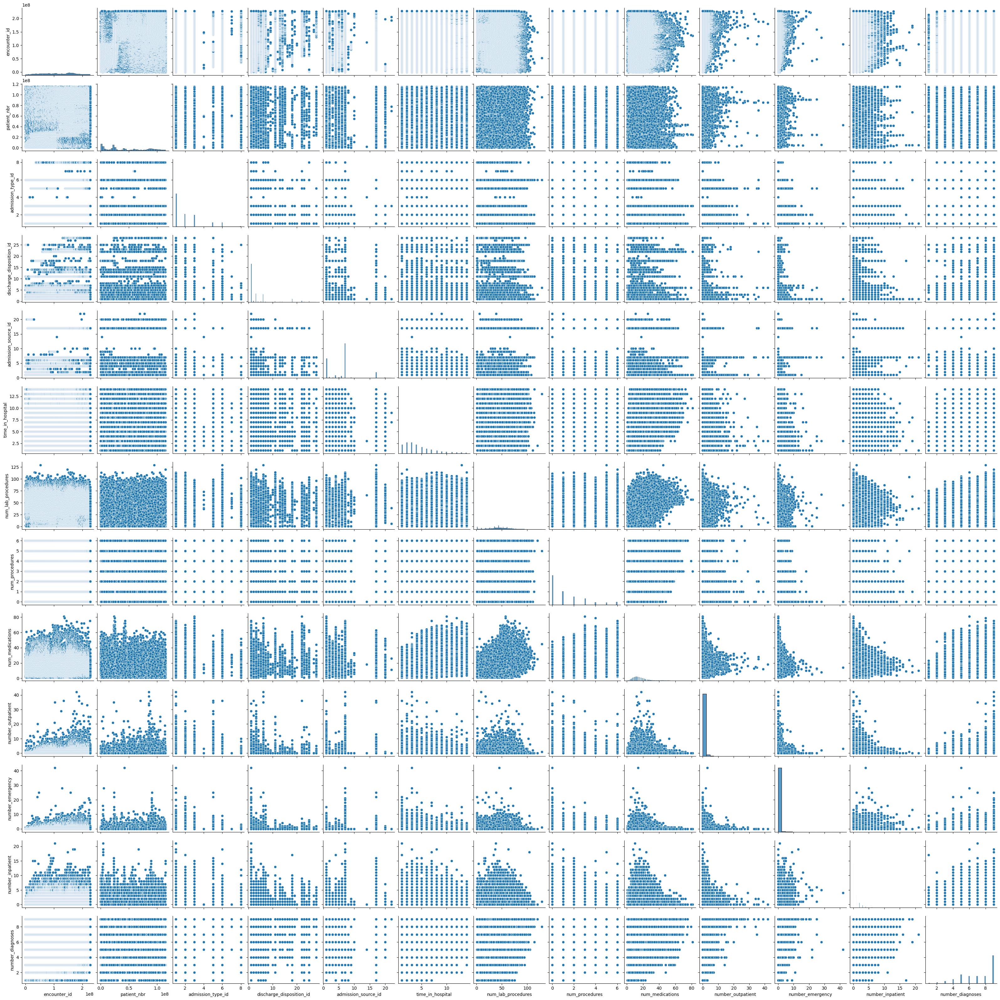

Pair Plots: Mostram scatter plots para todas as combinações de variáveis numéricas.


In [ ]:
# 7. Pair Plots
# Os pair plots mostram scatter plots para todas as combinações de variáveis numéricas e histogramas para as variáveis individuais.
# Eles nos ajudam a entender a relação entre as variáveis e identificar possíveis padrões nos dados.
sns.pairplot(df, kind='scatter')
plt.show()
print("Pair Plots: Mostram scatter plots para todas as combinações de variáveis numéricas.")

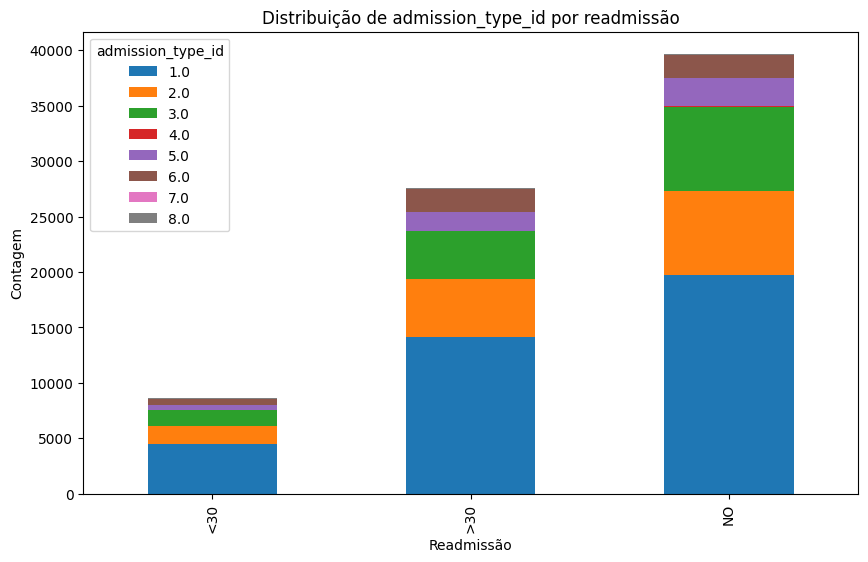

In [ ]:
# Contagem de ocorrências para cada classe
cat_counts = df.groupby("readmitted")["admission_type_id"].value_counts().unstack()

# Plotagem
cat_counts.plot(kind="bar", stacked=True, figsize=(10,6))
plt.title("Distribuição de admission_type_id por readmissão")
plt.xlabel("Readmissão")
plt.ylabel("Contagem")
plt.legend(title="admission_type_id")
plt.show()


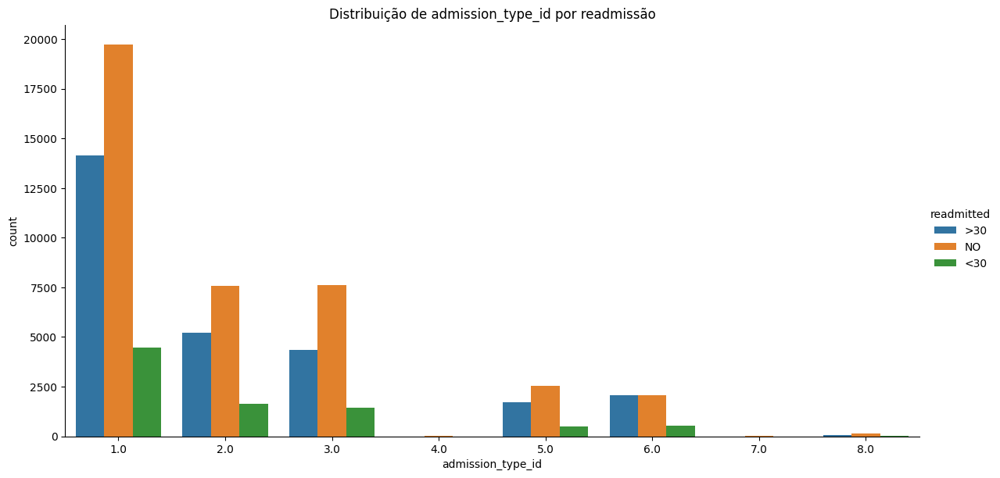

In [ ]:
sns.catplot(data=df, x="admission_type_id", hue="readmitted", kind="count", height=6, aspect=2)
plt.title("Distribuição de admission_type_id por readmissão")
plt.show()


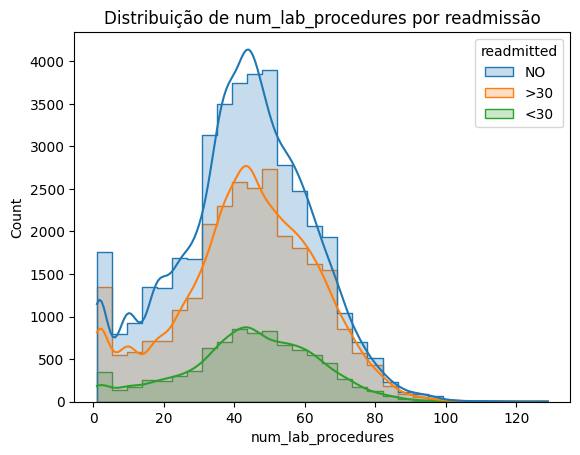

In [ ]:
# Comparação da variável 'num_lab_procedures' entre classes de 'readmitted'
sns.histplot(data=df, x="num_lab_procedures", hue="readmitted", kde=True, bins=30, element="step")
plt.title("Distribuição de num_lab_procedures por readmissão")
plt.show()


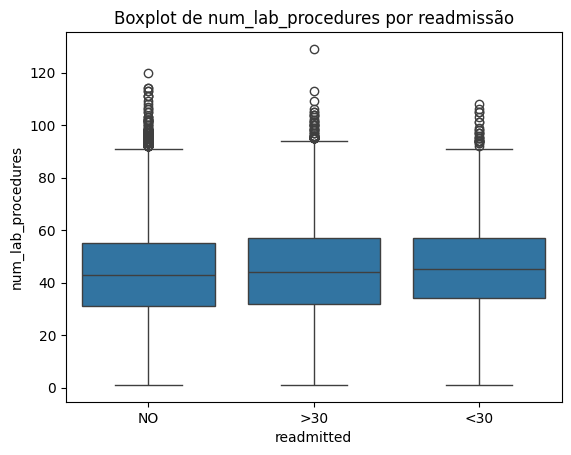

In [ ]:
sns.boxplot(data=df, x="readmitted", y="num_lab_procedures")
plt.title("Boxplot de num_lab_procedures por readmissão")
plt.show()


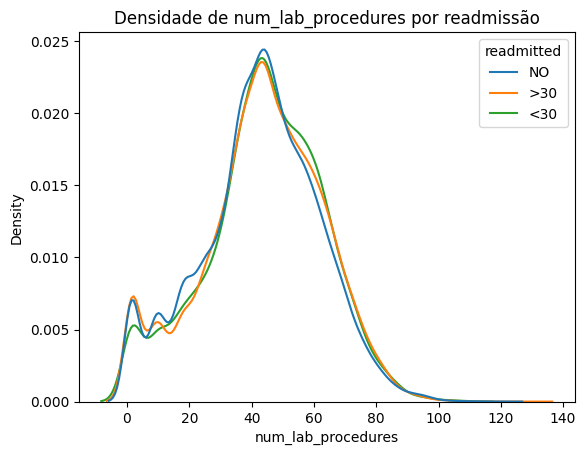

In [ ]:
sns.kdeplot(data=df, x="num_lab_procedures", hue="readmitted", common_norm=False)
plt.title("Densidade de num_lab_procedures por readmissão")
plt.show()


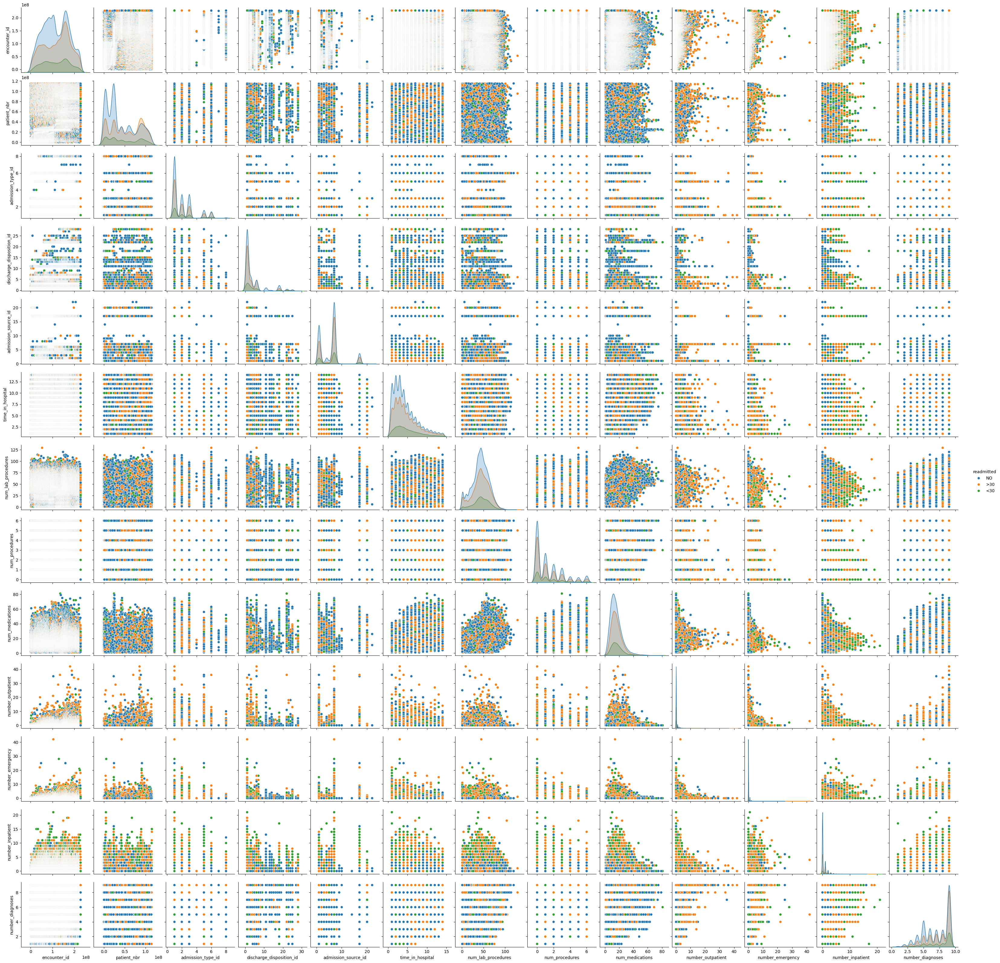

In [ ]:
sns.pairplot(df, hue="readmitted", diag_kind="kde")
plt.show()